# **Lab 2.1 Image Enhancement with Math Operation**
This lab consists of two main subparts: Image Pixel Adjustment using Linear Equations and Gamma Equations.

In [183]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
from mpl_toolkits.axes_grid1 import ImageGrid
import os
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

Read an image using OpenCV (Use your own image).

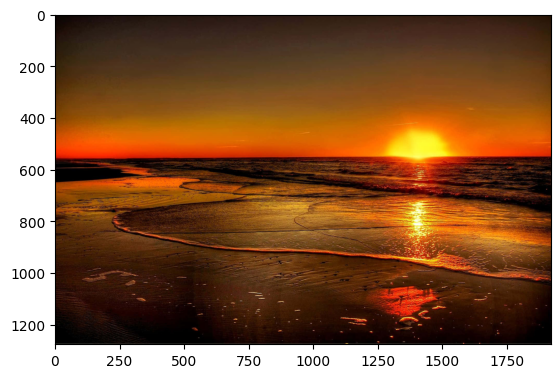

In [184]:
### START CODE HERE ###
img = cv2.imread('./img/image3.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)


plt.imshow(img)
### END CODE HERE ###

## **Image Pixel Adjustment**

### Using Linear Equation
$$I_{new} = I \cdot a + b$$

Please perform at ***least 20 iterations*** with varying values of $a$ and $b$.
Assign the result of each iteration to an array.<br/>

In [185]:
### START CODE HERE ###
a = np.linspace(0.3, 2.0, 40)  # 40 values of a from 0.3 to 2.0
b = np.linspace(0, 50, 40)   # 40 values of b from 0 to 50

lin_result = []

for a_val, b_val in zip(a, b):
    adjusted = img.astype(np.float64)  # Convert to float for precision
    adjusted = adjusted * a_val + b_val
    adjusted = np.clip(adjusted, 0, 255)
    adjusted = adjusted.astype(np.uint8)

    lin_result.append(adjusted)
    
### END CODE HERE ###


Plot the images in a grid as shown below. Using `ImageGrid`.
<details>

<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>

- The output should resemble this, but not be identical
- The reference output used 40 iterations.

![image-2.png](https://raw.githubusercontent.com/Digital-Image-Processing-Laboratory/Image-Processing-Course-2025/main/Lab2_Image-Enhancement/assets/1-1.png?raw=true)
</details>


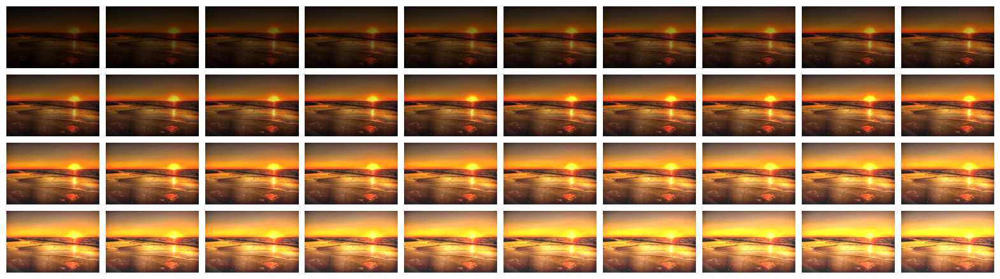

In [186]:
### START CODE HERE ###

fig = plt.figure(figsize=(20, 10))

grid = ImageGrid(fig, 111, nrows_ncols=(4, 10), axes_pad=0.1)

for ax, img in zip(grid, lin_result):
    ax.imshow(img)
    ax.axis('off')


plt.show()
### END CODE HERE ###

If you code work properly, the cell below should run without error.

In [187]:
assert len(lin_result) >= 20, f"Expected more than or equal 20 iterations but got {len(lin_result)}"
for idx, result in enumerate(lin_result):
    assert result.shape == img.shape, f"Shape mismatch at index {idx}. Expected {img.shape} but got {result.shape}"
    assert result.dtype == np.uint8, f"Data type mismatch at index {idx}. Expected uint8 but got {result.dtype}"
    assert np.all((result >= 0) & (result <= 255)), f"Pixel value out of bounds at index {idx}"

Save the array of images to a video. Please complete the function below.

In [188]:
### START CODE HERE ###
def write_images_to_video(image_array, output_file, frame_rate=30):
    image_array = [cv2.cvtColor(img, cv2.COLOR_RGB2BGR) for img in image_array]  # Convert RGB to BGR for OpenCV
    height, width = image_array[0].shape[0], image_array[0].shape[1]
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    # print(fourcc)
    video = cv2.VideoWriter(output_file, fourcc, frame_rate, (width, height))
    for img in image_array:
        video.write(img)
    video.release()
    
### END CODE HERE ###

Use `write_images_to_video()` and save the result.

In [189]:
output_folder = "output"
os.makedirs(output_folder, exist_ok=True)

output_file =  os.path.join(output_folder, "output_linear.mp4")
write_images_to_video(lin_result,output_file)

Now use `matplotlib.animation` to display the animation from the images array.

In [190]:
%%capture
### START CODE HERE ###

fig, ax = plt.subplots()
ax.axis('off')
frames = []
for img in lin_result:
    frame = [ax.imshow(img)]
    frames.append(frame)

ani = animation.ArtistAnimation(fig, frames, interval=100, blit=True)

<details>
<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>

- The output should resemble this, but not be identical

![linear.gif](![<attachment:linear (2).gif>](https://raw.githubusercontent.com/Digital-Image-Processing-Laboratory/Image-Processing-Course-2025/main/Lab2_Image-Enhancement/assets/linear.gif?raw=true))

</details>

In [191]:
display(HTML(ani.to_jshtml()))

### Gamma Equation
$$I_{new} = I^{\gamma} \cdot a + b$$

Where $a$ is 1 and $b$ is 0. 
Please perform ***at least 10 iterations*** for 0 < $\gamma$ < 1 and another ***at least 10 iterations*** for $\gamma$ > 1
Assign the result of each iteration to an array.<br/>


In [201]:
### START CODE HERE ###
a = 1
b = 0
# gamma = 0.1  # Initial gamma value

gam_result = []
gammas_1 = np.linspace(0.1, 0.9, 10) # 0 < gamma < 1
gammas_2 = np.linspace(1.1, 3.0, 10) # 1 < gamma 

def adjust_gamma(img, result, gamma_list):
    
    norm_img = img.astype(np.float64) / 255.0  # Normalize the image to [0, 1]
    
    for gamma in gamma_list:
        
        adjusted = ((norm_img ** gamma) * a + b) * 255  # Scale back to [0, 255]
        adjusted = np.clip(adjusted, 0, 255).astype(np.uint8)  # Ensure uint8 for clipping
        adjusted = adjusted.astype(np.uint8)
        
        result.append(adjusted)

adjust_gamma(img, gam_result, gammas_1)
adjust_gamma(img, gam_result, gammas_2)

# for gamma in gammas_1:
#     adjusted = (img ** gamma) * a + b
#     adjusted = np.clip(adjusted, 0, 255)
#     adjusted = adjusted.astype(np.uint8)
    
#     gam_result.append(adjusted)
    

# for gamma in gammas_2:
#     adjusted = (img ** gamma) * a + b
#     adjusted = np.clip(adjusted, 0, 255)
#     adjusted = adjusted.astype(np.uint8)

#     gam_result.append(adjusted)
    
### END CODE HERE ###

Plot the images in a grid as shown below. Using `ImageGrid`.
<details>

<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>

- The output should resemble this, but not be identical

![image-2.png](https://raw.githubusercontent.com/Digital-Image-Processing-Laboratory/Image-Processing-Course-2025/main/Lab2_Image-Enhancement/assets/1-2.png?raw=true)
</details>

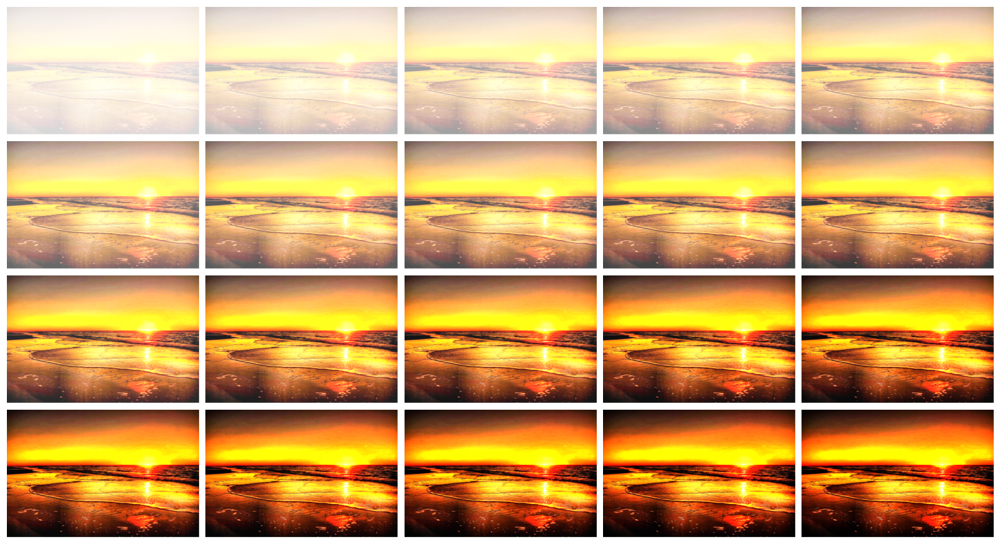

In [193]:
### START CODE HERE ###

fig = plt.figure(figsize=(20, 10))

grid = ImageGrid(fig, 111, nrows_ncols=(4, 5), axes_pad=0.1)

for ax, img in zip(grid, gam_result):
    ax.imshow(img)
    ax.axis('off')

plt.show()
### END CODE HERE ###

In [194]:
assert len(gam_result) >= 20, f"more than or equal 20 iterations but got {len(gam_result)}"
for idx, result in enumerate(gam_result):
    assert result.shape == img.shape, f"Shape mismatch at index {idx}. Expected {img.shape} but got {result.shape}"
    assert result.dtype == np.uint8, f"Data type mismatch at index {idx}. Expected uint8 but got {result.dtype}"
    assert np.all((result >= 0) & (result <= 255)), f"Pixel value out of bounds at index {idx}"

Use `write_images_to_video()` and save the result.

In [195]:
output_folder = "output"
os.makedirs(output_folder, exist_ok=True)

output_file =  os.path.join(output_folder, "output_gamma.mp4")
write_images_to_video(gam_result,output_file)

Now use `matplotlib.animation` to display the animation from the images array.

In [196]:
%%capture
### START CODE HERE ###

fig, ax = plt.subplots()
ax.axis('off')
frames = []
for img in gam_result:
    frame = [ax.imshow(img)]
    frames.append(frame)

ani = animation.ArtistAnimation(fig, frames, interval=100, blit=True)
### END CODE HERE ###

<details>
<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>

- The output should resemble this, but not be identical

![gamma2.gif](https://raw.githubusercontent.com/Digital-Image-Processing-Laboratory/Image-Processing-Course-2025/main/Lab2_Image-Enhancement/assets/gamma.gif?raw=true)

</details>

In [197]:
display(HTML(ani.to_jshtml()))

---

## **Questions**
1. If an image having over brightness or saturation, what would be possible solutions to enhance the image.
2. How can we make an image reverse intensity (black-to-white, white-to-black)? Explain the process

## **Answers**
1. ลดความสว่าง(Brightness)ลง โดยใช้ค่า gamma > 1 ทำให้ภาพมืดลง หรือ
2. นำ 255 - img จะได้ภาพเป็นแบบ reverse (สีที่ตรงข้ามกัน)

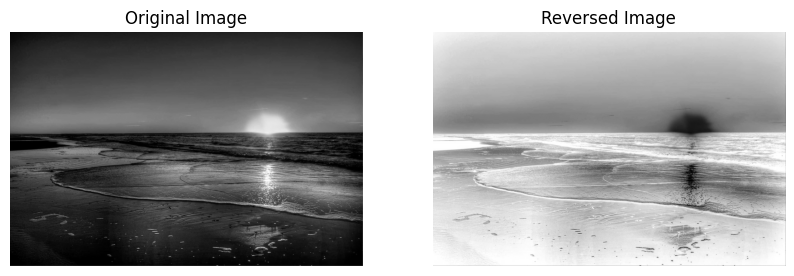

In [198]:
# Reverse intensity (black-to-white, white-to-black)
img = cv2.imread('./img/image3.jpg')
img1 = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
r_img = 255 - img1

fig, ax = plt.subplots(1, 2, figsize=(10, 5))

ax[0].set_title('Original Image')
ax[0].imshow(img1, cmap='gray')
ax[0].axis('off')

ax[1].set_title('Reversed Image')
ax[1].axis('off')
ax[1].imshow(r_img, cmap='gray')

plt.show()

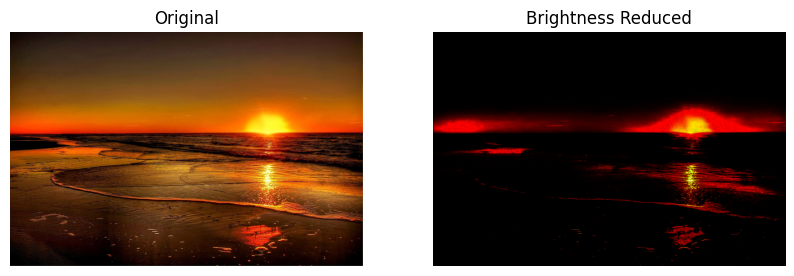

In [199]:
# Brightness reduction
img2 = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
gamma = 10

# วิธี 1: ลดความสว่าง (Brightness)
brightness_offset = 10 

norm_img = img2 / 255.0  # Normalize the image to [0, 1]
adjusted = ((norm_img ** gamma) * a + b) * 255  # Scale back to [0, 255]
adjusted = np.clip(adjusted, 0, 255).astype(np.uint8)  # Ensure uint8 for clipping
adjusted = adjusted.astype(np.uint8)

img_darker = np.clip(adjusted, 0, 255).astype(np.uint8)

# แสดงภาพ
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(img2)
plt.title("Original")
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(img_darker)
plt.title("Brightness Reduced")
plt.axis('off')
plt.show()

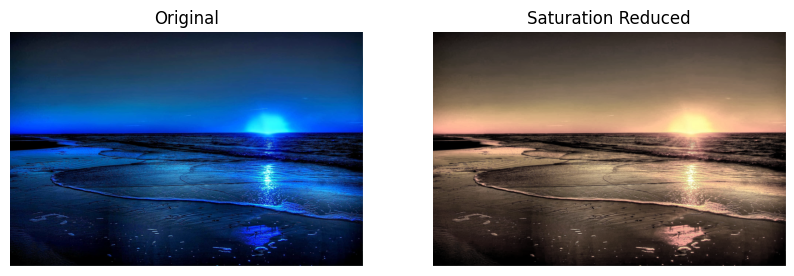

In [200]:
img_hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

# ลดค่า Saturation (S channel)
img_hsv[:, :, 1] = np.clip(img_hsv[:, :, 1] * 0.4, 0, 255)  # ลด S ลง 50%
img_less_saturation = cv2.cvtColor(img_hsv, cv2.COLOR_HSV2RGB)

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(img)
plt.title("Original")
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(img_less_saturation)
plt.title("Saturation Reduced")
plt.axis('off')
plt.show()